In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Import Data

In [22]:
brain_data = pd.read_csv('./data/eig_centrality.csv', header=None)
brain_data.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
0,1,-0.067894,-0.062832,0,0,0,-0.031240,-0.071004,0,0,...,-0.112760,-0.106070,0.000000e+00,0.000000e+00,-0.028195,-0.024616,-0.042535,-0.087451,0.003145,-0.047196
1,1,0.031793,0.025996,0,0,0,0.122030,0.109220,0,0,...,0.078364,0.049836,0.000000e+00,6.938900e-18,-0.076947,-0.078418,-0.064815,0.095082,0.054585,0.076347
2,1,-0.005251,-0.015806,0,0,0,-0.124040,-0.117020,0,0,...,0.021125,0.014470,0.000000e+00,-1.734700e-18,0.068705,0.084321,0.047107,0.004649,-0.142760,-0.129450
3,1,0.123150,0.096576,0,0,0,-0.045236,-0.005143,0,0,...,-0.043127,-0.024063,5.551100e-17,-1.110200e-16,-0.064510,-0.100380,-0.112950,-0.099919,-0.006036,-0.004228
4,1,-0.059846,-0.024500,0,0,0,-0.022105,0.022153,0,0,...,-0.026404,-0.004397,-4.336800e-19,0.000000e+00,-0.068379,0.006091,-0.050172,0.056009,0.077894,0.016500


# Data preprocessing

In [23]:
# take the absolute value of the dataframe
brain_data = brain_data.abs()
brain_data.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
0,1,0.067894,0.062832,0,0,0,0.031240,0.071004,0,0,...,0.112760,0.106070,0.000000e+00,0.000000e+00,0.028195,0.024616,0.042535,0.087451,0.003145,0.047196
1,1,0.031793,0.025996,0,0,0,0.122030,0.109220,0,0,...,0.078364,0.049836,0.000000e+00,6.938900e-18,0.076947,0.078418,0.064815,0.095082,0.054585,0.076347
2,1,0.005251,0.015806,0,0,0,0.124040,0.117020,0,0,...,0.021125,0.014470,0.000000e+00,1.734700e-18,0.068705,0.084321,0.047107,0.004649,0.142760,0.129450
3,1,0.123150,0.096576,0,0,0,0.045236,0.005143,0,0,...,0.043127,0.024063,5.551100e-17,1.110200e-16,0.064510,0.100380,0.112950,0.099919,0.006036,0.004228
4,1,0.059846,0.024500,0,0,0,0.022105,0.022153,0,0,...,0.026404,0.004397,4.336800e-19,0.000000e+00,0.068379,0.006091,0.050172,0.056009,0.077894,0.016500


# Means

In [24]:
# Data statistics
brain_data.describe()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
count,60.000000,60.000000,60.000000,60.0,60.0,60.0,60.000000,60.000000,60.0,60.0,...,60.000000,60.000000,6.000000e+01,6.000000e+01,60.000000,60.000000,60.000000,60.000000,60.000000,60.000000
mean,0.516667,0.055419,0.049001,0.0,0.0,0.0,0.059917,0.048897,0.0,0.0,...,0.051085,0.049278,1.328597e-18,6.037126e-18,0.049552,0.050190,0.046855,0.040444,0.052034,0.049811
std,0.503939,0.037961,0.035131,0.0,0.0,0.0,0.037384,0.034295,0.0,0.0,...,0.026703,0.028768,7.276080e-18,2.127807e-17,0.030178,0.031586,0.034787,0.028978,0.036327,0.032592
min,0.000000,0.001816,0.000304,0.0,0.0,0.0,0.001140,0.003158,0.0,0.0,...,0.004677,0.001023,0.000000e+00,0.000000e+00,0.000118,0.001077,0.000986,0.000065,0.002263,0.000845
25%,0.000000,0.031381,0.021933,0.0,0.0,0.0,0.029482,0.023082,0.0,0.0,...,0.031109,0.023802,0.000000e+00,0.000000e+00,0.028087,0.022155,0.014115,0.015463,0.021457,0.023328
50%,1.000000,0.049955,0.041759,0.0,0.0,0.0,0.055389,0.040224,0.0,0.0,...,0.049698,0.053847,0.000000e+00,0.000000e+00,0.045397,0.049169,0.041444,0.037324,0.046289,0.047913
75%,1.000000,0.076700,0.067842,0.0,0.0,0.0,0.092647,0.073694,0.0,0.0,...,0.068650,0.072389,0.000000e+00,1.084195e-18,0.068460,0.073953,0.067117,0.063200,0.075635,0.073472
max,1.000000,0.147730,0.147670,0.0,0.0,0.0,0.147870,0.119670,0.0,0.0,...,0.112760,0.106070,5.551100e-17,1.110200e-16,0.111630,0.111860,0.120680,0.102510,0.142760,0.129450


<AxesSubplot:title={'center':'All'}, xlabel='Feature', ylabel='mean of features'>

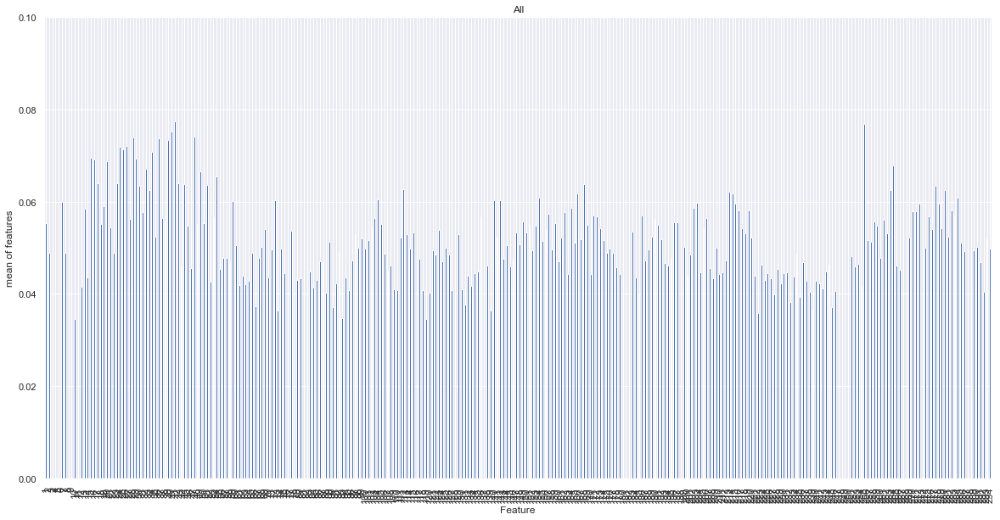

In [25]:
# plot means of all feature for all patients
brain_data.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(0,0.1), title='All')

## Plot means for patients without alz


In [26]:
brain_data_control = brain_data[brain_data[0] == 0]
brain_data_control.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
31,0,0.073850,0.067370,0,0,0,0.039203,0.007984,0,0,...,0.083530,0.088748,0.000000e+00,0.000000e+00,0.009333,0.003645,0.004680,0.005652,0.058902,0.021986
32,0,0.007477,0.030839,0,0,0,0.027184,0.006316,0,0,...,0.041812,0.075199,0.000000e+00,1.734700e-18,0.107040,0.111130,0.059544,0.040218,0.007276,0.017958
33,0,0.018437,0.061860,0,0,0,0.103210,0.077021,0,0,...,0.054337,0.054819,1.734700e-18,6.938900e-18,0.032942,0.059597,0.017278,0.093595,0.003241,0.035667
34,0,0.036331,0.046393,0,0,0,0.104860,0.050941,0,0,...,0.107930,0.092007,5.421000e-20,0.000000e+00,0.048051,0.006444,0.088322,0.010914,0.099691,0.095473
35,0,0.076509,0.060253,0,0,0,0.004090,0.025761,0,0,...,0.063173,0.041957,0.000000e+00,0.000000e+00,0.098832,0.085524,0.117420,0.064931,0.014703,0.000845


<AxesSubplot:title={'center':'Control'}, xlabel='Feature', ylabel='mean of features'>

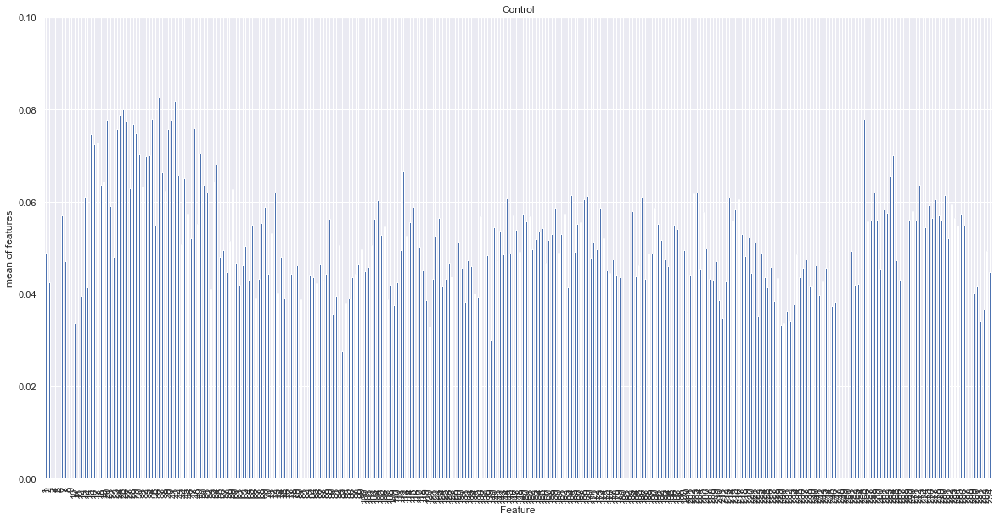

In [27]:
brain_data_control.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(0,0.1), title='Control')

## Plot means for patients with alz

In [28]:
brain_data_alz = brain_data[brain_data[0] == 1]
brain_data_alz.head()

,0,1,2,3,4,5,6,7,8,9,...,285,286,287,288,289,290,291,292,293,294
0,1,0.067894,0.062832,0,0,0,0.031240,0.071004,0,0,...,0.112760,0.106070,0.000000e+00,0.000000e+00,0.028195,0.024616,0.042535,0.087451,0.003145,0.047196
1,1,0.031793,0.025996,0,0,0,0.122030,0.109220,0,0,...,0.078364,0.049836,0.000000e+00,6.938900e-18,0.076947,0.078418,0.064815,0.095082,0.054585,0.076347
2,1,0.005251,0.015806,0,0,0,0.124040,0.117020,0,0,...,0.021125,0.014470,0.000000e+00,1.734700e-18,0.068705,0.084321,0.047107,0.004649,0.142760,0.129450
3,1,0.123150,0.096576,0,0,0,0.045236,0.005143,0,0,...,0.043127,0.024063,5.551100e-17,1.110200e-16,0.064510,0.100380,0.112950,0.099919,0.006036,0.004228
4,1,0.059846,0.024500,0,0,0,0.022105,0.022153,0,0,...,0.026404,0.004397,4.336800e-19,0.000000e+00,0.068379,0.006091,0.050172,0.056009,0.077894,0.016500


# All Feature means and medians plots

<AxesSubplot:title={'center':'Control: median'}, xlabel='Feature', ylabel='median of features'>

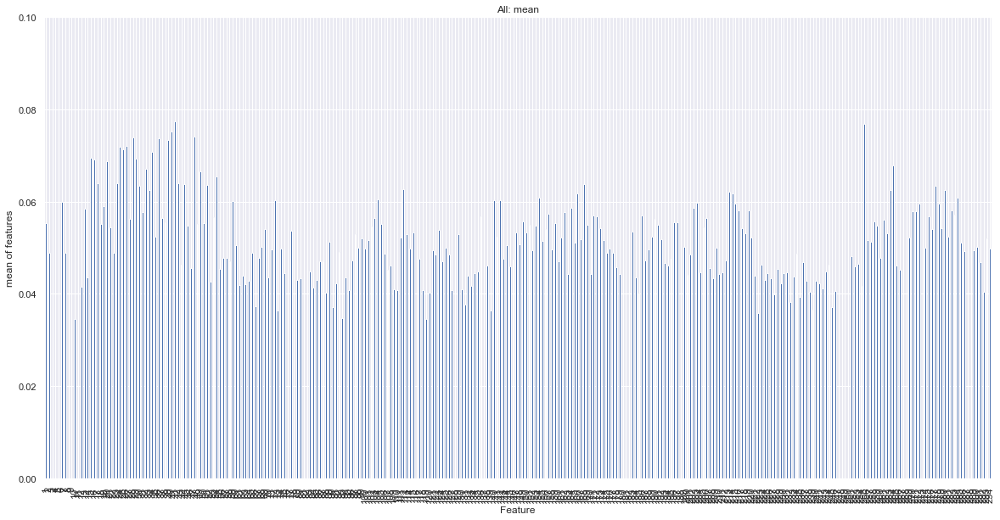

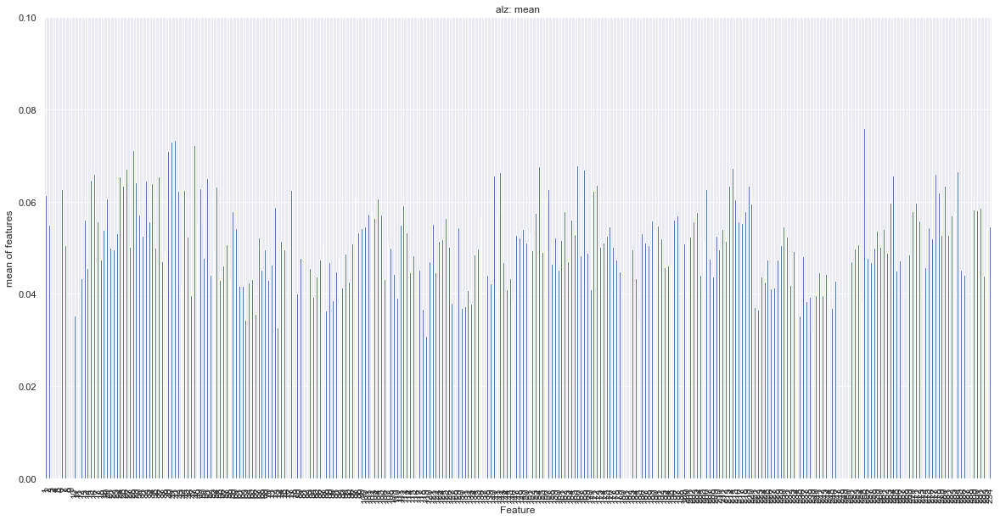

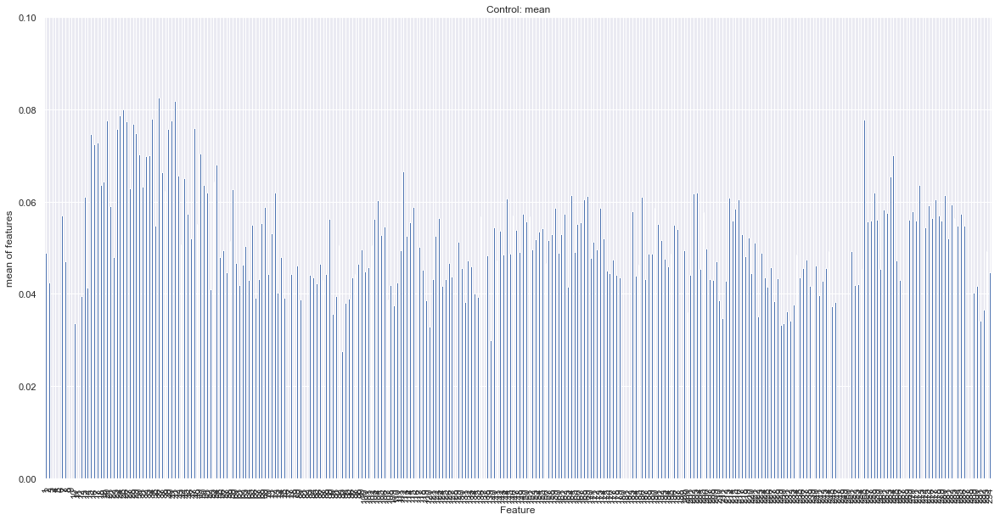

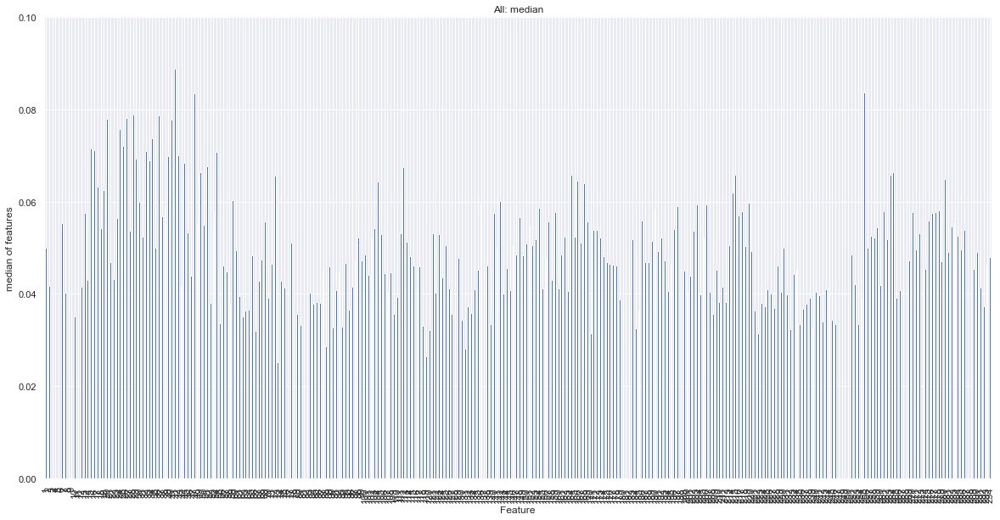

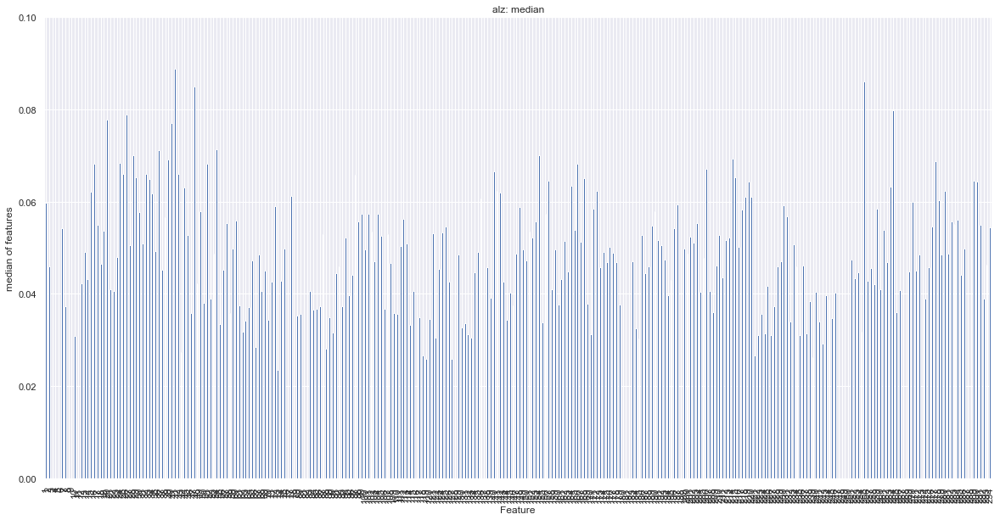

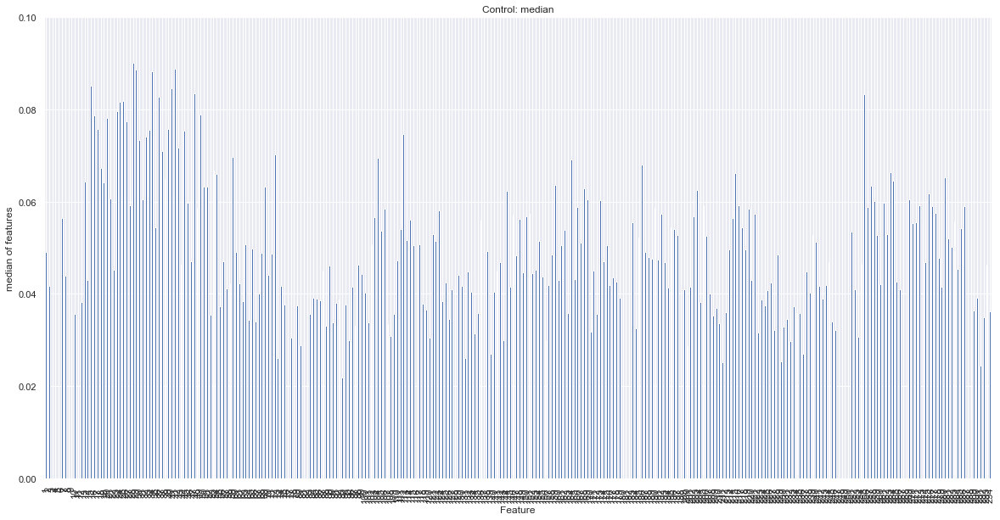

In [29]:
plt.figure()
brain_data.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(0,0.1), title='All: mean')
plt.figure()
brain_data_alz.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(0,0.1), title='alz: mean')
plt.figure()
brain_data_control.iloc[:,1:].mean().plot(kind='bar', figsize=(20,10), ylabel='mean of features', xlabel='Feature', ylim=(0,0.1), title='Control: mean')
plt.figure()
brain_data.iloc[:,1:].median().plot(kind='bar', figsize=(20,10), ylabel='median of features', xlabel='Feature', ylim=(0,0.1), title='All: median')
plt.figure()
brain_data_alz.iloc[:,1:].median().plot(kind='bar', figsize=(20,10), ylabel='median of features', xlabel='Feature', ylim=(0,0.1), title='alz: median')
plt.figure()
brain_data_control.iloc[:,1:].median().plot(kind='bar', figsize=(20,10), ylabel='median of features', xlabel='Feature', ylim=(0,0.1), title='Control: median')


# Putting it all together with mean and median

# View into individual patients

<AxesSubplot:>

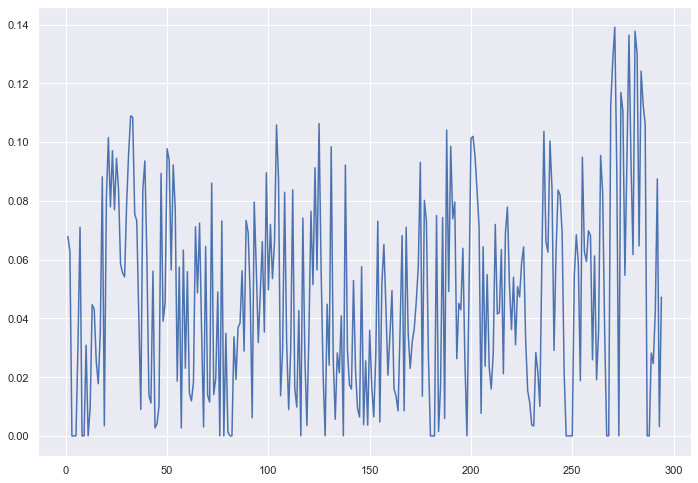

In [30]:
# plotting features of a single patient
one_patient = brain_data.iloc[0, 1:]
one_patient.plot()

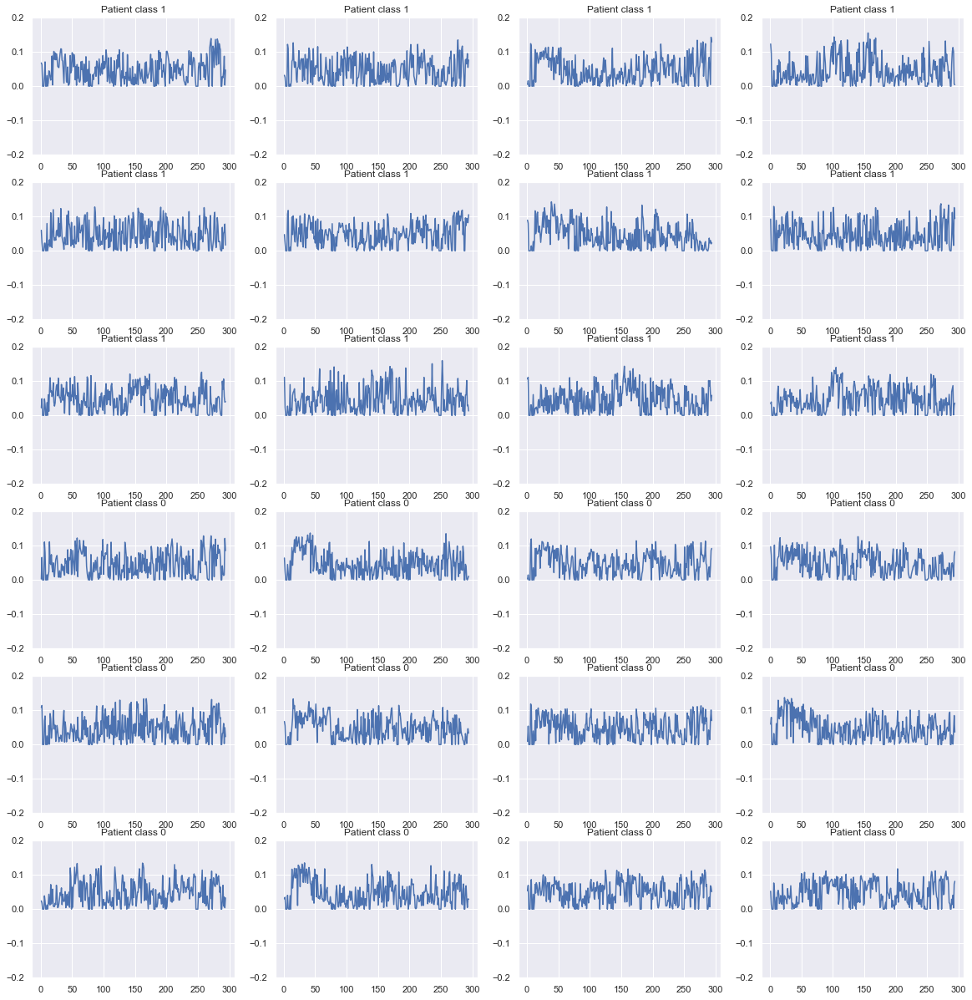

In [31]:
# Plot for several patients
num_patients = 25
num_cols = 4

## Create a position index
Rows = num_patients // num_cols
Rows += num_patients % num_cols
Position = range(1, num_patients + 1)

## Create Figure
fig = plt.figure(1, figsize=(20,90))
for x in range(num_patients//2):
    ax = fig.add_subplot(num_patients, num_cols, Position[x])
    brain_data.iloc[x, 1:].plot(title=f'Patient class {brain_data.iloc[x, 0]}', ylim=(-.2,.2))

for x in range(num_patients//2):
    ax = fig.add_subplot(num_patients, num_cols, Position[num_patients//2+x])
    brain_data.iloc[len(brain_data)-1-x, 1:].plot(title=f'Patient class {brain_data.iloc[len(brain_data)-1-x, 0]}', ylim=(-.2,.2))

# Distribution of features

array([[<AxesSubplot:title={'center':'1'}>,
        <AxesSubplot:title={'center':'2'}>,
        <AxesSubplot:title={'center':'3'}>,
        <AxesSubplot:title={'center':'4'}>,
        <AxesSubplot:title={'center':'5'}>,
        <AxesSubplot:title={'center':'6'}>,
        <AxesSubplot:title={'center':'7'}>,
        <AxesSubplot:title={'center':'8'}>,
        <AxesSubplot:title={'center':'9'}>],
       [<AxesSubplot:title={'center':'10'}>,
        <AxesSubplot:title={'center':'11'}>,
        <AxesSubplot:title={'center':'12'}>,
        <AxesSubplot:title={'center':'13'}>,
        <AxesSubplot:title={'center':'14'}>,
        <AxesSubplot:title={'center':'15'}>,
        <AxesSubplot:title={'center':'16'}>,
        <AxesSubplot:title={'center':'17'}>,
        <AxesSubplot:title={'center':'18'}>],
       [<AxesSubplot:title={'center':'19'}>,
        <AxesSubplot:title={'center':'20'}>,
        <AxesSubplot:title={'center':'21'}>,
        <AxesSubplot:title={'center':'22'}>,
        <AxesSubp

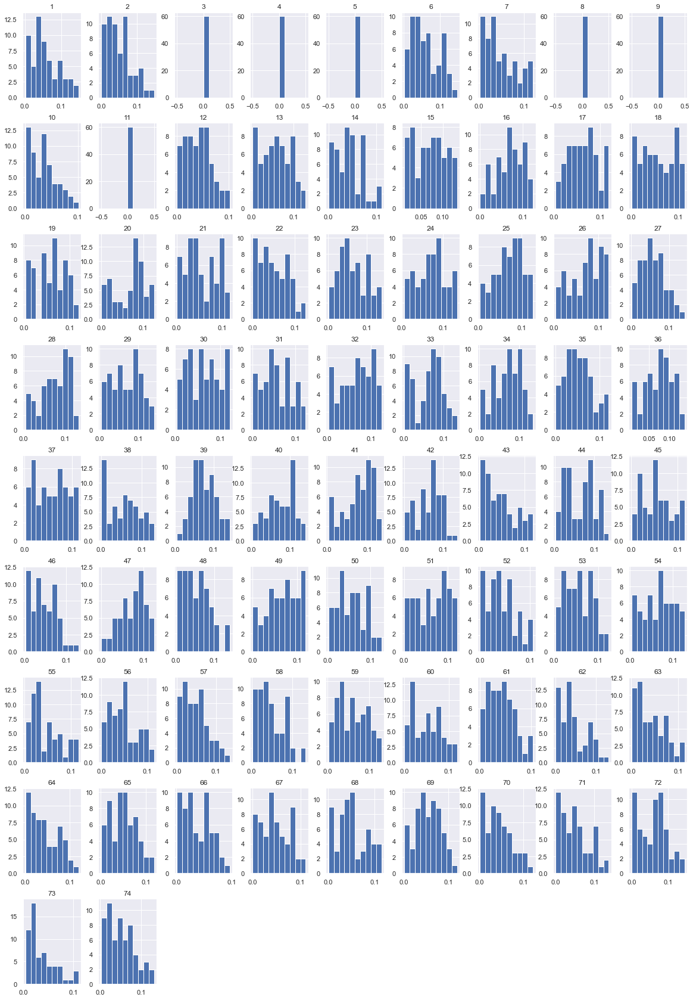

In [32]:
brain_data.iloc[:,1:75].hist(figsize=(20,30))

array([[<AxesSubplot:title={'center':'75'}>,
        <AxesSubplot:title={'center':'76'}>,
        <AxesSubplot:title={'center':'77'}>,
        <AxesSubplot:title={'center':'78'}>,
        <AxesSubplot:title={'center':'79'}>,
        <AxesSubplot:title={'center':'80'}>,
        <AxesSubplot:title={'center':'81'}>,
        <AxesSubplot:title={'center':'82'}>,
        <AxesSubplot:title={'center':'83'}>],
       [<AxesSubplot:title={'center':'84'}>,
        <AxesSubplot:title={'center':'85'}>,
        <AxesSubplot:title={'center':'86'}>,
        <AxesSubplot:title={'center':'87'}>,
        <AxesSubplot:title={'center':'88'}>,
        <AxesSubplot:title={'center':'89'}>,
        <AxesSubplot:title={'center':'90'}>,
        <AxesSubplot:title={'center':'91'}>,
        <AxesSubplot:title={'center':'92'}>],
       [<AxesSubplot:title={'center':'93'}>,
        <AxesSubplot:title={'center':'94'}>,
        <AxesSubplot:title={'center':'95'}>,
        <AxesSubplot:title={'center':'96'}>,
        

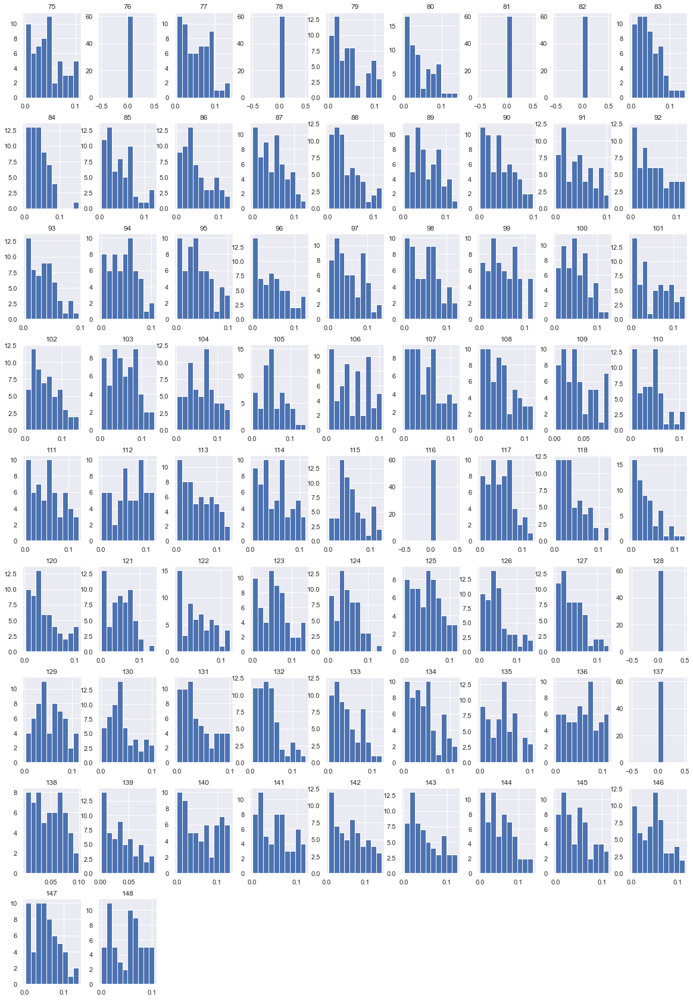

In [33]:
brain_data.iloc[:,75:149].hist(figsize=(20,30))

# Correlations

<AxesSubplot:>

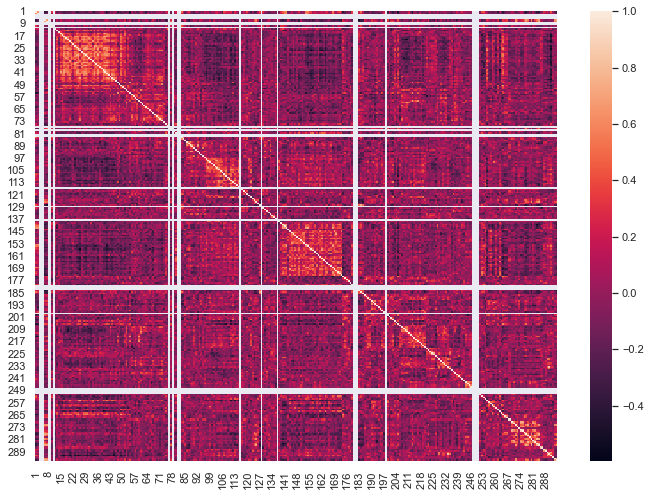

In [34]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.heatmap(brain_data.iloc[:,1:].corr())

# Standard Deviations

In [42]:
standard_dev = brain_data.describe().loc['std'][1:]
standard_dev

1      0.037961
2      0.035131
3      0.000000
4      0.000000
5      0.000000
         ...   
290    0.031586
291    0.034787
292    0.028978
293    0.036327
294    0.032592
Name: std, Length: 294, dtype: float64

<AxesSubplot:>

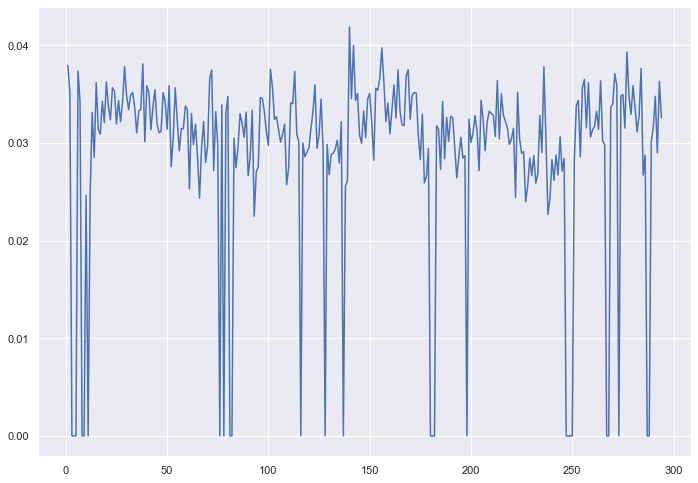

In [43]:
standard_dev.plot()

In [44]:
# Filter out zeros
standard_dev = standard_dev[standard_dev != 0]
standard_dev

1      0.037961
2      0.035131
6      0.037384
7      0.034295
10     0.024646
         ...   
290    0.031586
291    0.034787
292    0.028978
293    0.036327
294    0.032592
Name: std, Length: 273, dtype: float64

<AxesSubplot:>

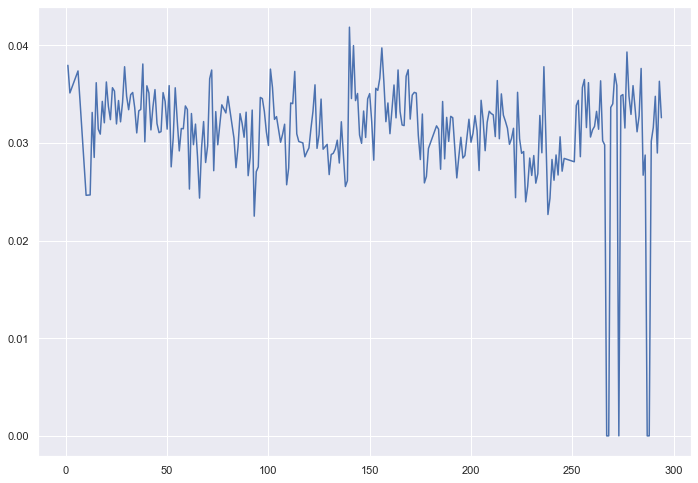

In [45]:
standard_dev.plot()

In [46]:
standard_dev.sort_values()

267    1.553970e-36
268    2.486326e-35
273    2.546099e-32
287    7.276080e-18
288    2.127807e-17
           ...     
38     3.809752e-02
277    3.932461e-02
156    3.974284e-02
142    3.998260e-02
140    4.186798e-02
Name: std, Length: 273, dtype: float64

In [47]:
brain_data.iloc[:, 267]

0     0.000000e+00
1     9.183500e-41
2     0.000000e+00
3     0.000000e+00
4     0.000000e+00
5     0.000000e+00
6     0.000000e+00
7     0.000000e+00
8     0.000000e+00
9     0.000000e+00
10    0.000000e+00
11    0.000000e+00
12    0.000000e+00
13    0.000000e+00
14    0.000000e+00
15    0.000000e+00
16    0.000000e+00
17    0.000000e+00
18    0.000000e+00
19    0.000000e+00
20    0.000000e+00
21    0.000000e+00
22    4.591800e-41
23    0.000000e+00
24    0.000000e+00
25    0.000000e+00
26    0.000000e+00
27    0.000000e+00
28    0.000000e+00
29    0.000000e+00
30    4.591800e-41
31    0.000000e+00
32    0.000000e+00
33    0.000000e+00
34    0.000000e+00
35    0.000000e+00
36    0.000000e+00
37    0.000000e+00
38    0.000000e+00
39    0.000000e+00
40    0.000000e+00
41    0.000000e+00
42    0.000000e+00
43    0.000000e+00
44    0.000000e+00
45    0.000000e+00
46    0.000000e+00
47    0.000000e+00
48    0.000000e+00
49    0.000000e+00
50    0.000000e+00
51    1.203700e-35
52    0.0000

In [48]:
brain_data.iloc[:, 268]

0     0.000000e+00
1     0.000000e+00
2     0.000000e+00
3     0.000000e+00
4     0.000000e+00
5     0.000000e+00
6     0.000000e+00
7     0.000000e+00
8     0.000000e+00
9     0.000000e+00
10    0.000000e+00
11    0.000000e+00
12    0.000000e+00
13    0.000000e+00
14    0.000000e+00
15    0.000000e+00
16    0.000000e+00
17    0.000000e+00
18    0.000000e+00
19    0.000000e+00
20    0.000000e+00
21    0.000000e+00
22    0.000000e+00
23    0.000000e+00
24    0.000000e+00
25    0.000000e+00
26    0.000000e+00
27    0.000000e+00
28    0.000000e+00
29    0.000000e+00
30    0.000000e+00
31    0.000000e+00
32    0.000000e+00
33    0.000000e+00
34    0.000000e+00
35    0.000000e+00
36    0.000000e+00
37    0.000000e+00
38    0.000000e+00
39    0.000000e+00
40    9.183500e-41
41    0.000000e+00
42    0.000000e+00
43    0.000000e+00
44    0.000000e+00
45    0.000000e+00
46    0.000000e+00
47    0.000000e+00
48    0.000000e+00
49    0.000000e+00
50    0.000000e+00
51    1.925900e-34
52    0.0000

In [49]:
brain_data.iloc[:, 287]

0     0.000000e+00
1     0.000000e+00
2     0.000000e+00
3     5.551100e-17
4     4.336800e-19
5     0.000000e+00
6     0.000000e+00
7     2.168400e-19
8     2.710500e-20
9     6.938900e-18
10    0.000000e+00
11    0.000000e+00
12    0.000000e+00
13    0.000000e+00
14    0.000000e+00
15    0.000000e+00
16    0.000000e+00
17    0.000000e+00
18    0.000000e+00
19    4.336800e-19
20    0.000000e+00
21    0.000000e+00
22    6.938900e-18
23    0.000000e+00
24    0.000000e+00
25    0.000000e+00
26    0.000000e+00
27    2.168400e-19
28    0.000000e+00
29    0.000000e+00
30    2.168400e-19
31    0.000000e+00
32    0.000000e+00
33    1.734700e-18
34    5.421000e-20
35    0.000000e+00
36    0.000000e+00
37    0.000000e+00
38    0.000000e+00
39    6.938900e-18
40    0.000000e+00
41    0.000000e+00
42    0.000000e+00
43    0.000000e+00
44    0.000000e+00
45    0.000000e+00
46    0.000000e+00
47    0.000000e+00
48    0.000000e+00
49    0.000000e+00
50    0.000000e+00
51    0.000000e+00
52    0.0000